<a href="https://colab.research.google.com/github/easyone-nlp/transformer-/blob/main/ddm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🔥 확산 모델

<table align="left">
  <td>
    <a href="https://colab.research.google.com/github/rickiepark/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/08_diffusion/01_ddm/ddm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
  </td>
</table>

In [ ]:
import sys

# 코랩의 경우 깃허브 저장소로부터 utils.py를 다운로드 합니다.
# sys.modules에서 'google.colab' 모듈이 존재하는지를 확인
if 'google.colab' in sys.modules:
    # 코드에서 필요로 하는 유틸리티 함수들을 포함하고 있는 파일
    !wget https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
    !mkdir -p notebooks
    # 다운로드한 utils.py를 notebooks 디렉토리로 이동
    !mv utils.py notebooks
    # output 디렉토리를 만듭니다.
    !mkdir output
    !mkdir models
else:
    sys.path.append('../../../')

--2024-12-23 12:09:29--  https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 771 [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]     771  --.-KB/s    in 0s      

2024-12-23 12:09:29 (36.5 MB/s) - ‘utils.py’ saved [771/771]



이 노트북에서는 옥스포드 플라워 데이터셋에서 확산 모델을 훈련합니다.

이 코드는 케라스 웹사이트에 있는 András Béres가 만든 훌륭한 ['잡음 제거 확산 암묵 모델' 튜토리얼](https://keras.io/examples/generative/ddim/)을 참고했습니다.

## 필요한 library 불러오기

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_palette('colorblind')

import math

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    optimizers,
    utils,
    callbacks,
    metrics,
    losses,
    activations,
)

# 다운 받은 utils 파일에서 함수 불러오기
from notebooks.utils import display, sample_batch

## 0. 파라미터 <a name="parameters"></a>

In [ ]:
IMAGE_SIZE = 64
BATCH_SIZE = 64
DATASET_REPETITIONS = 5
LOAD_MODEL = False

NOISE_EMBEDDING_SIZE = 32
PLOT_DIFFUSION_STEPS = 20

# 최적화
EMA = 0.999
LEARNING_RATE = 1e-3
WEIGHT_DECAY = 1e-4
EPOCHS = 50

## 1. 데이터 준비

In [ ]:
# 코랩일 경우 노트북에서 celeba 데이터셋을 받습니다.
if 'google.colab' in sys.modules:
    # 캐글-->Setttings-->API-->Create New Token에서
    # kaggle.json 파일을 만들어 코랩에 업로드하세요.
    #from google.colab import files
    #files.upload()
    #!mkdir ~/.kaggle
    #!cp kaggle.json ~/.kaggle/
    #!chmod 600 ~/.kaggle/kaggle.json

    # celeba 데이터셋을 다운로드하고 압축을 해제합니다.
    # 코랩에서 캐글 데이터 다운로드
    !kaggle datasets download -d nunenuh/pytorch-challange-flower-dataset
    !unzip -q pytorch-challange-flower-dataset.zip
    # output 디렉토리를 만듭니다.
    #!mkdir output

Dataset URL: https://www.kaggle.com/datasets/nunenuh/pytorch-challange-flower-dataset
License(s): CC0-1.0
100% 329M/330M [00:01<00:00, 214MB/s]
100% 330M/330M [00:01<00:00, 177MB/s]


In [ ]:
# 데이터 로드
train_data = utils.image_dataset_from_directory(
    "./dataset/",  # 이미지가 저장된 디렉토리 경로
    labels=None,  # 레이블 없이 이미지만 로드
    image_size=(IMAGE_SIZE, IMAGE_SIZE),  # 로드된 이미지를 지정된 크기로 리사이즈
    batch_size=None,  # 데이터를 배치로 나누지 않고 한 번에 반환
    shuffle=True,  # 데이터를 무작위로 섞어 로드
    seed=42,  # 데이터를 섞는 순서를 결정하는 난수 생성기의 초기값을 설정
    interpolation="bilinear",  # 선형 보간법으로 픽셀 값을 계산합니다. 일반적으로 부드러운 이미지를 제공
)

Found 8189 files.


In [ ]:
# 데이터 전처리
def preprocess(img):  # 전처리 단계에서 이미지를 float32 타입으로 변환하고, 픽셀 값을 0~1 범위로 정규화
    img = tf.cast(img, "float32") / 255.0
    return img


train = train_data.map(lambda x: preprocess(x))  # 데이터셋에서 하나씩 가져온 이미지 x를 preprocess 함수에 전달하여 정규화
train = train.repeat(DATASET_REPETITIONS)  # Diffusion 모델 학습에서는 데이터셋 크기가 부족한 경우 이를 반복하여 학습이 충분히 이루어지도록 만듭니다.
train = train.batch(BATCH_SIZE, drop_remainder=True)
#  한 번의 학습 단계에서 모델에 입력으로 주어지는 데이터 묶음의 크기
#  마지막 배치가 BATCH_SIZE보다 작은 경우 이를 제외

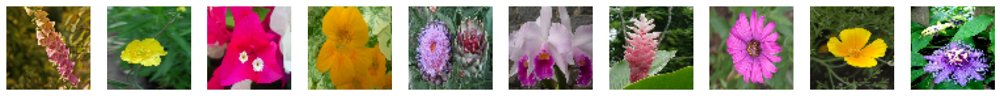

In [ ]:
# 훈련 세트에 있는 몇 개의 꽃 이미지를 출력합니다.
train_sample = sample_batch(train)
display(train_sample)

### 1.1 확산 스케줄 <a name="diffusion_schedules"></a>

# Diffusion Schedule이란?
Diffusion schedule은 Diffusion 모델에서 노이즈를 점진적으로 추가하는 과정에서 사용하는 파라미터를 정의하는 방식입니다.
Diffusion 모델은 이미지 생성 과정에서 데이터를 정확히 복원하기 위해, 노이즈를 단계별로 추가/제거합니다.
여기서 diffusion schedule은 각 단계에서 추가되는 노이즈의 비율과 신호의 비율을 조절합니다.



1. beta 계산 방식: 노이즈 비율을 선형적으로 증가시키기 위해 사용됩니다.
2. 신호 비율: 원본 데이터를 유지하는 비율로, Forward 과정에서 신호를 보존하고 Reverse 과정에서 복원에 사용됩니다.
3. 노이즈 비율:
Forward 과정에서 노이즈를 점진적으로 추가하며, Reverse 과정에서 모델이 노이즈를 제거할 수 있도록 학습합니다.

In [ ]:
def linear_diffusion_schedule(diffusion_times):
    # 최소 노이즈 비율
    min_rate = 0.0001  # Diffusion 시작 단계에서의 노이즈 비율 (매우 작은 값).
    # 최대 노이즈 비율
    max_rate = 0.02    # Diffusion 마지막 단계에서의 노이즈 비율 (상대적으로 큰 값).

    # 각 step에서 노이즈 비율(beta)을 선형적으로 증가시킴
    betas = min_rate + diffusion_times * (max_rate - min_rate)

    # 각 step에서 신호 유지 비율 (alpha)
    alphas = 1 - betas

    # 누적 신호 유지 비율 (alpha_bar)
    alpha_bars = tf.math.cumprod(alphas)  # alpha 값을 누적 곱으로 계산.

    # 신호 비율
    signal_rates = tf.sqrt(alpha_bars)  # 신호 유지 비율의 제곱근.

    # 노이즈 비율
    noise_rates = tf.sqrt(1 - alpha_bars)  # 노이즈 비율의 제곱근.

    # 노이즈와 신호 비율 반환
    return noise_rates, signal_rates

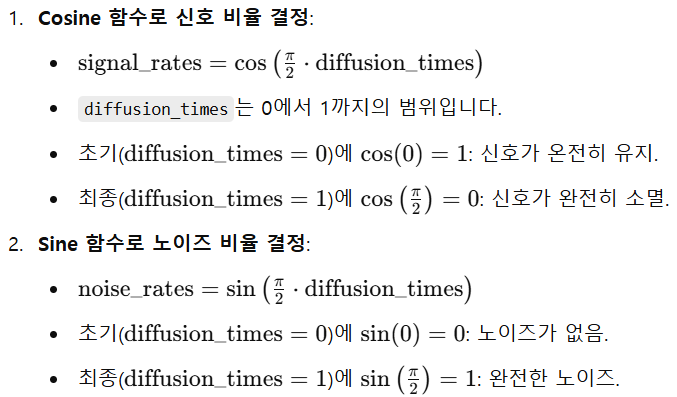

In [ ]:
def cosine_diffusion_schedule(diffusion_times):
    signal_rates = tf.cos(diffusion_times * math.pi / 2)
    noise_rates = tf.sin(diffusion_times * math.pi / 2)
    return noise_rates, signal_rates

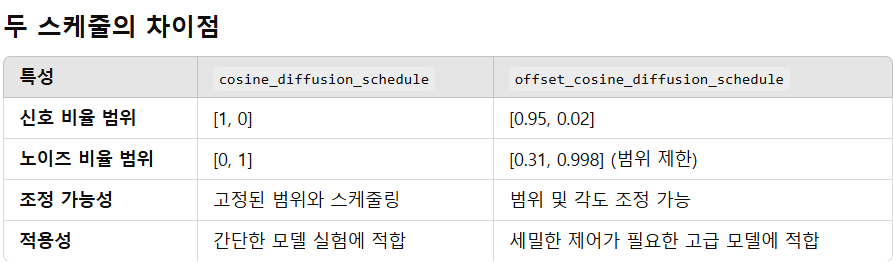

In [ ]:
def offset_cosine_diffusion_schedule(diffusion_times):
    min_signal_rate = 0.02
    max_signal_rate = 0.95
    start_angle = tf.acos(max_signal_rate)
    end_angle = tf.acos(min_signal_rate)

    diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

    signal_rates = tf.cos(diffusion_angles)
    noise_rates = tf.sin(diffusion_angles)

    return noise_rates, signal_rates

In [ ]:
T = 1000
diffusion_times = tf.convert_to_tensor([x / T for x in range(T)])  # [0,0.001,0.002,…,0.999]와 같습니다

# 각 diffusion schedule을 변수에 저장
linear_noise_rates, linear_signal_rates = linear_diffusion_schedule(
    diffusion_times
)
cosine_noise_rates, cosine_signal_rates = cosine_diffusion_schedule(
    diffusion_times
)
(
    offset_cosine_noise_rates,
    offset_cosine_signal_rates,
) = offset_cosine_diffusion_schedule(diffusion_times)

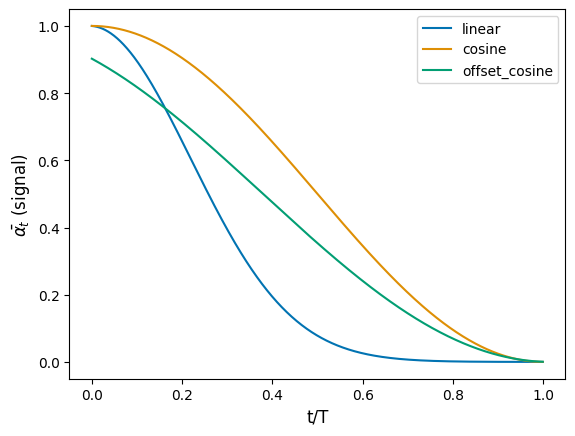

In [ ]:
# 세 개의 signal rate을 비교
plt.plot(
    diffusion_times, linear_signal_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_signal_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_signal_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$\bar{\alpha_t}$ (signal)", fontsize=12)
plt.legend()
plt.show()

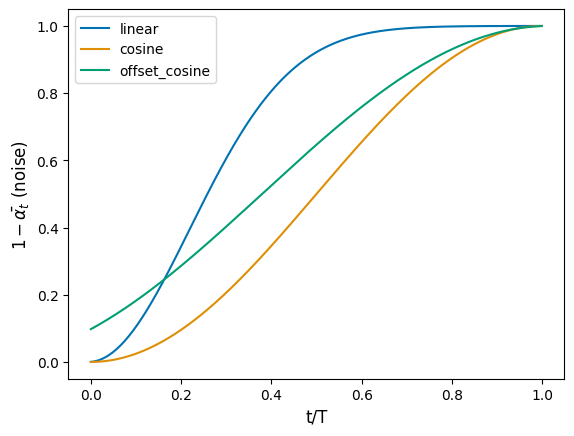

In [ ]:
# 세 개의 noise rate을 비교
plt.plot(
    diffusion_times, linear_noise_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_noise_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_noise_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$1-\bar{\alpha_t}$ (noise)", fontsize=12)
plt.legend()
plt.show()

## 2. 모델 구축 <a name="build"></a>

In [ ]:
# 여러 주파수로 변환하면 t의 정보를 고차원 공간에 효과적으로 매핑할 수 있습니다.
from keras.saving import register_keras_serializable

@register_keras_serializable()
def sinusoidal_embedding(x):
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(1.0),
            tf.math.log(1000.0),
            NOISE_EMBEDDING_SIZE // 2,
        )  # 지정된 범위에서 균등하게 간격을 나눈 값을 생성, log(1.0)부터 log(1000.0)까지 NOISE_EMBEDDING_SIZE/2 개의 값을 생성
    )  # 저주파수부터 고주파수까지 다양한 스케일을 커버하는 주파수 배열 생성
    # frequencies=[1.0,…,1000.0]
    angular_speeds = 2.0 * math.pi * frequencies  # 각속도
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )  # 사인과 코사인 결과를 마지막 차원(axis=3)에 따라 합칩니다.
    return embeddings
    # 결과 임베딩의 차원: (batch_size, sequence_length, :, NOISE_EMBEDDING_SIZE)

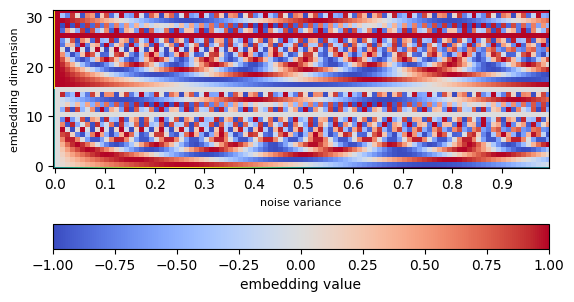

In [ ]:
embedding_list = []
for y in np.arange(0, 1, 0.01):
    embedding_list.append(sinusoidal_embedding(np.array([[[[y]]]]))[0][0][0])
    # sinusoidal_embedding(np.array([[[[y]]]])):입력 x는 차원이 (1, 1, 1, 1)인 텐서로 변환됩니다.
    # [0][0][0]: 결과 텐서에서 첫 번째 값을 선택해 1D 형태로 만듭니다.
embedding_array = np.array(np.transpose(embedding_list))
fig, ax = plt.subplots()
ax.set_xticks(
    np.arange(0, 100, 10), labels=np.round(np.arange(0.0, 1.0, 0.1), 1)
)
ax.set_ylabel("embedding dimension", fontsize=8)
ax.set_xlabel("noise variance", fontsize=8)
plt.pcolor(embedding_array, cmap="coolwarm")
plt.colorbar(orientation="horizontal", label="embedding value")
ax.imshow(embedding_array, interpolation="nearest", origin="lower")
plt.show()

# U-NET 구조
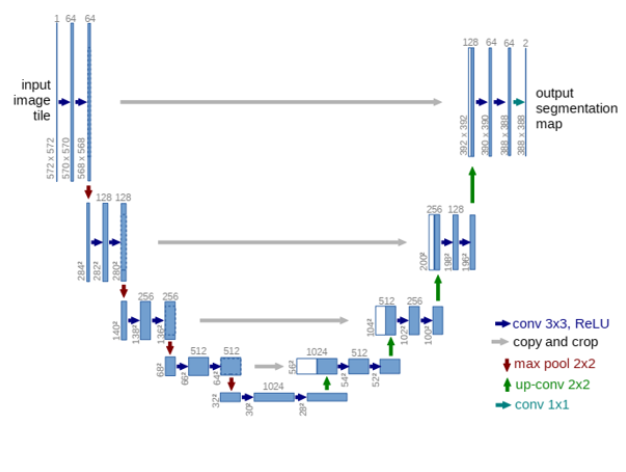

In [ ]:
# 입력 x를 변환한 후 원래 입력과 더하는 방식으로 계산
def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x  # 만약 입력 폭과 목표 폭이 같다면, x를 그대로 잔차(residual)로 사용.
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
            # 폭이 다르면 x를 1×1 컨볼루션으로 변환해 채널 폭을 맞춥니다.

        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=activations.swish
        )(x)  # 두 개의 3×3 컨볼루션 연산을 수행. Swish 활성화 함수를 사용
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)

        x = layers.Add()([x, residual])  #  변환된 x와 잔차(residual)를 더합니다.
        return x

    return apply

# 이미지를 더 낮은 해상도로 축소(다운샘플링)하면서, Residual Block을 사용해 특징을 추출
# U-Net의 인코더 부분에서 사용됩니다.
def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):  # block_depth만큼 Residual Block을 반복 적용
            x = ResidualBlock(width)(x)
            skips.append(x)

        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply

# 이미지를 더 높은 해상도로 복원(업샘플링)하면서, Residual Block과 스킵 연결(skip connection)을 사용해 특징을 재결합합니다.
# U-Net의 디코더 부분에서 사용됩니다.
def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)  # 입력 x를 2×2 업샘플링해 해상도를 증가

        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply

In [ ]:
# U-Net 구축

noisy_images = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))  # 크기가 (IMAGE_SIZE, IMAGE_SIZE, 3)인 RGB 이미지를 나타냅니다.
x = layers.Conv2D(32, kernel_size=1)(noisy_images)  # 1x1 필터를 사용하여 입력 이미지의 특징을 추출하며, 각 픽셀에서 채널 수를 줄이거나 늘리는 역할을 합니다.

noise_variances = layers.Input(shape=(1, 1, 1))  # 이미지에 섞인 노이즈의 강도를 나타내는 값입니다.
# Sinusoidal Embedding 및 업샘플링
noise_embedding = layers.Lambda(sinusoidal_embedding)(noise_variances)  # 노이즈의 시간 단계 정보(t)를 효과적으로 인코딩하기 위해 사용됩니다.
noise_embedding = layers.UpSampling2D(size=IMAGE_SIZE, interpolation="nearest")(  # noise_embedding을 원본 이미지 크기(IMAGE_SIZE)로 확장하여 공간 차원을 맞춥니다.
    noise_embedding
)

# 이미지의 특징 맵(x)과 노이즈 임베딩(noise_embedding)을 결합하여, 모델이 입력 이미지와 노이즈 수준을 동시에 이해할 수 있도록 합니다.
x = layers.Concatenate()([x, noise_embedding])

skips = []

# DownBlock을 이용한 다운샘플링
# 특징의 공간적 크기를 줄이고 채널 수를 늘립니다.
x = DownBlock(32, block_depth=2)([x, skips])
x = DownBlock(64, block_depth=2)([x, skips])
x = DownBlock(96, block_depth=2)([x, skips])

# Residual Block으로 중앙 특징 추출
# 고유한 특징을 추출하기 위한 블록입니다.
x = ResidualBlock(128)(x)
x = ResidualBlock(128)(x)

# UpBlock을 이용한 업샘플링
# 다운샘플링에서 저장된 skips와 결합하여, 원본 이미지의 세부 정보를 복원하는 데 도움을 줍니다.
x = UpBlock(96, block_depth=2)([x, skips])
x = UpBlock(64, block_depth=2)([x, skips])
x = UpBlock(32, block_depth=2)([x, skips])

# 1x1 필터를 사용하여 출력 채널을 3으로 줄입니다. 이는 RGB 이미지로 복원하기 위함입니다.
# kernel_initializer="zeros"는 초기화 시 필터의 가중치를 0으로 설정합니다. 이는 모델이 처음에는 아무런 영향을 주지 않도록 하기 위함입니다.
x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

# 입력은 [noisy_images, noise_variances]이고, 출력은 노이즈가 제거된 이미지입니다.
unet = models.Model([noisy_images, noise_variances], x, name="unet")

In [ ]:
class DiffusionModel(models.Model):
    # 클래스 초기화 (__init__)
    def __init__(self):
        super().__init__()

        self.normalizer = layers.Normalization()  # normalizer: 입력 이미지를 정규화하는 레이어.
        self.network = unet  # network: 기본 네트워크는 이전에 정의한 unet입니다.
        self.ema_network = models.clone_model(self.network)  # ema_network: EMA(Exponential Moving Average) 가중치를 사용하는 네트워크로, 학습 중 모델 안정화를 위해 사용됩니다.
        self.diffusion_schedule = offset_cosine_diffusion_schedule  # diffusion_schedule: 노이즈 및 신호 비율을 정의하는 offset cosine schedule을 사용합니다.

    def compile(self, **kwargs):
        super().compile(**kwargs)
        self.noise_loss_tracker = metrics.Mean(name="n_loss")  # compile: 모델의 컴파일 단계에서 추가로 noise_loss_tracker를 정의하여 노이즈 예측 손실을 추적합니다.

    @property
    def metrics(self):  # 훈련 및 평가 시, 손실(n_loss)을 추적합니다.
        return [self.noise_loss_tracker]

    def denormalize(self, images):
        images = self.normalizer.mean + images * self.normalizer.variance**0.5  # 정규화를 해제하여 원래 픽셀 값(0~1) 범위로 변환합니다.
        return tf.clip_by_value(images, 0.0, 1.0)  # tf.clip_by_value는 픽셀 값을 [0, 1] 사이로 제한합니다.

    def denoise(self, noisy_images, noise_rates, signal_rates, training):  # noisy_images: 노이즈가 포함된 이미지, noise_rates: 노이즈 비율, signal_rates: 신호 비율.
        if training:
            network = self.network
        else:
            network = self.ema_network
        pred_noises = network(
            [noisy_images, noise_rates**2], training=training  # 네트워크를 통해 예측된 노이즈(pred_noises)를 계산.
        )
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates  # 예측된 노이즈를 이용해 원래 이미지를 복원(pred_images)합니다.

        return pred_noises, pred_images  # 예측된 노이즈와 복원된 이미지.

    def reverse_diffusion(self, initial_noise, diffusion_steps):  # initial_noise: 랜덤 노이즈, diffusion_steps: 역방향 diffusion 과정의 단계 수.

        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps
        current_images = initial_noise

        for step in range(diffusion_steps):
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(  # 반복적으로 denoise를 호출하여, 노이즈를 제거하고 점차 이미지를 복원.
                current_images, noise_rates, signal_rates, training=False
            )
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(  # 각 단계에서 다음 노이즈와 신호 비율(next_noise_rates, next_signal_rates)을 계산.
                next_diffusion_times
            )
            current_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises  # 새로운 이미지를 업데이트.
            )
        return pred_images  # 최종 복원된 이미지

    def generate(self, num_images, diffusion_steps, initial_noise=None):  # num_images: 생성할 이미지의 개수, diffusion_steps: 역방향 diffusion 단계 수, initial_noise: 초기 랜덤 노이즈 (선택 사항).
        if initial_noise is None:
            initial_noise = tf.random.normal(
                shape=(num_images, IMAGE_SIZE, IMAGE_SIZE, 3)
            )
        generated_images = self.reverse_diffusion(  # 초기 노이즈를 역방향 diffusion 과정에 전달하여 이미지 생성.
            initial_noise, diffusion_steps
        )
        generated_images = self.denormalize(generated_images)  # 생성된 이미지를 정규화 해제(denormalize)하여 반환.
        return generated_images  # 생성된 이미지.

    def train_step(self, images):
        images = self.normalizer(images, training=True)  # 입력 이미지를 정규화.
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))  # 노이

        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)

        noisy_images = signal_rates * images + noise_rates * noises  # 노이즈를 추가하여 noisy_images 생성.

        with tf.GradientTape() as tape:
            # 잡음 이미지에서 잡음을 구분하도록 훈련합니다.
            pred_noises, pred_images = self.denoise(  # 네트워크를 통해 노이즈 예측(pred_noises) 및 손실 계산.
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # 훈련에 사용

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(
            zip(gradients, self.network.trainable_weights)
        )

        self.noise_loss_tracker.update_state(noise_loss)

        for weight, ema_weight in zip(  # 역전파로 가중치 업데이트.
            self.network.weights, self.ema_network.weights  # EMA 네트워크 가중치 업데이트.
        ):
            ema_weight.assign(EMA * ema_weight + (1 - EMA) * weight)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, images):
        # 정규화된 이미지를 입력받아 노이즈를 추가.
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises
        # 노이즈 제거 후 손실(noise_loss)을 계산.
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )
        noise_loss = self.loss(noises, pred_noises)
        self.noise_loss_tracker.update_state(noise_loss)

        return {m.name: m.result() for m in self.metrics}

In [ ]:
ddm = DiffusionModel()
ddm.normalizer.adapt(train)  # 정규화 층(self.normalizer)을 학습
# train 데이터셋의 통계(평균 및 분산)를 계산하여, 데이터를 정규화하는 데 필요한 파라미터를 설정합니다.

In [ ]:
if LOAD_MODEL:
    ddm.built = True  # 모델이 빌드되었음을 수동으로 표시
    ddm.load_weights("./checkpoint/checkpoint.ckpt")  # 저장된 가중치를 로드
# built = True를 수동으로 설정하는 이유는 모델 가중치를 로드하기 전에 모델이 빌드되었다고 표시하여, TensorFlow가 이 과정을 생략하도록 하기 위함입니다.

## 3.모델 훈련 <a name="train"></a>

In [ ]:
from tensorflow.keras.losses import MeanAbsoluteError

ddm.compile(
    optimizer=optimizers.AdamW(
        learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    ),
    loss=MeanAbsoluteError())

Epoch 1/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.2992
Saved to ./output/generated_img_000.png


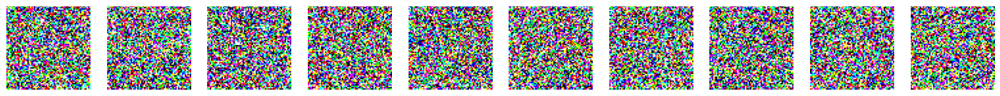

639/639 ━━━━━━━━━━━━━━━━━━━━ 55s 38ms/step - n_loss: 0.2991
Epoch 2/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1960
Saved to ./output/generated_img_001.png


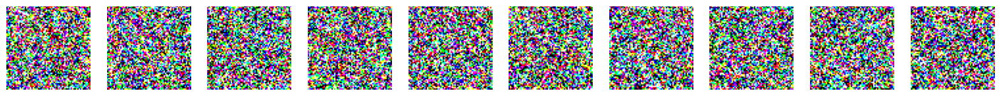

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1960
Epoch 3/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1911
Saved to ./output/generated_img_002.png


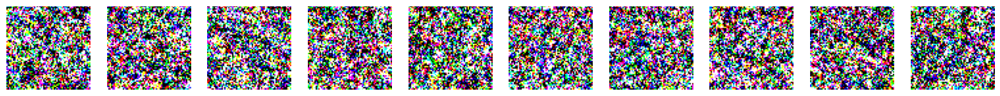

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1911
Epoch 4/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1861
Saved to ./output/generated_img_003.png


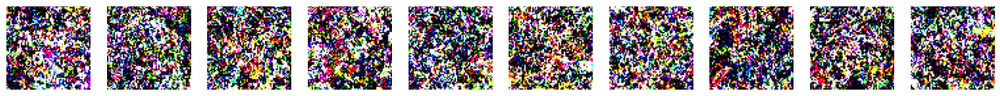

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1861
Epoch 5/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1837
Saved to ./output/generated_img_004.png


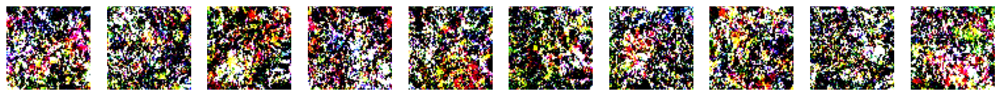

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1837
Epoch 6/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1824
Saved to ./output/generated_img_005.png


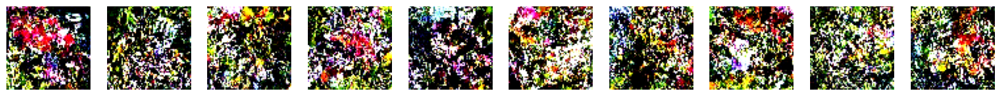

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1824
Epoch 7/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1811
Saved to ./output/generated_img_006.png


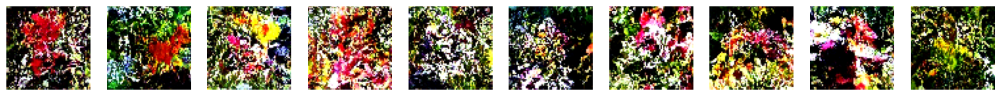

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1811
Epoch 8/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1792
Saved to ./output/generated_img_007.png


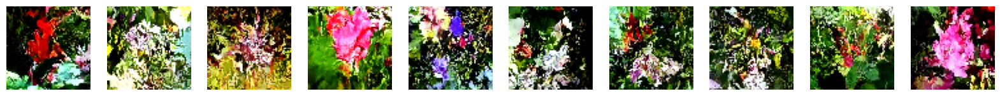

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1792
Epoch 9/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1783
Saved to ./output/generated_img_008.png


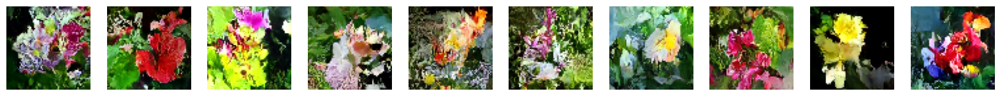

639/639 ━━━━━━━━━━━━━━━━━━━━ 24s 37ms/step - n_loss: 0.1783
Epoch 10/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1782
Saved to ./output/generated_img_009.png


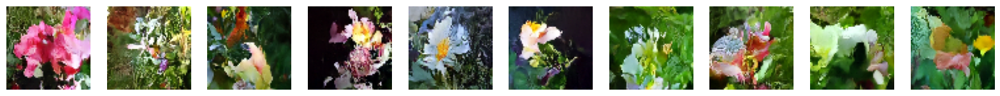

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1782
Epoch 11/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1773
Saved to ./output/generated_img_010.png


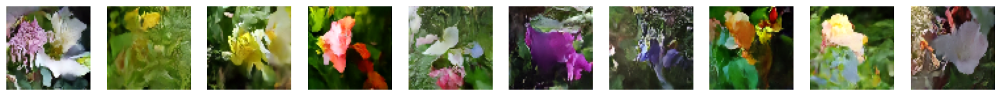

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1773
Epoch 12/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1771
Saved to ./output/generated_img_011.png


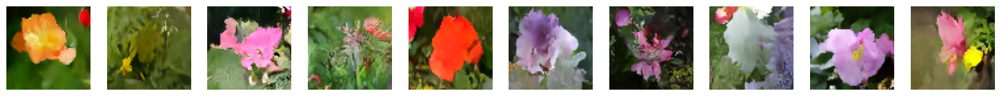

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1771
Epoch 13/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1769
Saved to ./output/generated_img_012.png


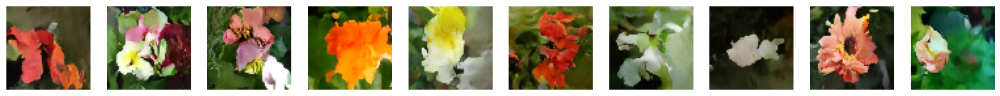

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1769
Epoch 14/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1761
Saved to ./output/generated_img_013.png


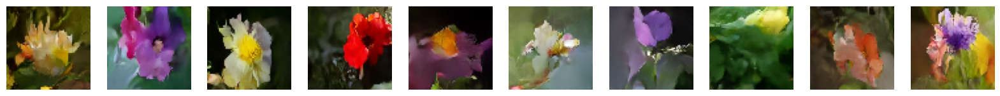

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1761
Epoch 15/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1760
Saved to ./output/generated_img_014.png


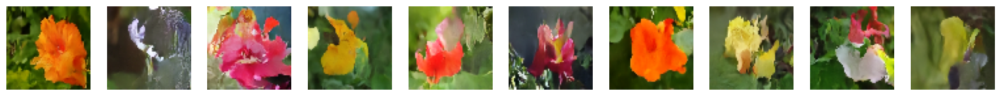

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1760
Epoch 16/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1761
Saved to ./output/generated_img_015.png


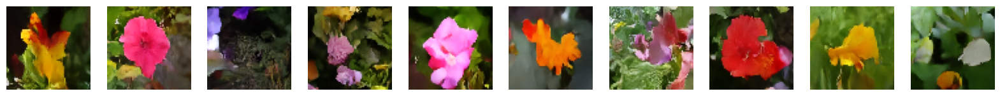

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1761
Epoch 17/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1750
Saved to ./output/generated_img_016.png


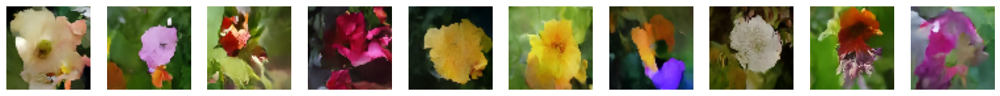

639/639 ━━━━━━━━━━━━━━━━━━━━ 24s 37ms/step - n_loss: 0.1750
Epoch 18/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1751
Saved to ./output/generated_img_017.png


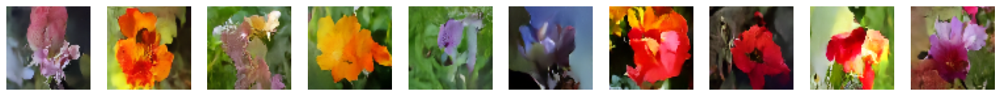

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1751
Epoch 19/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1742
Saved to ./output/generated_img_018.png


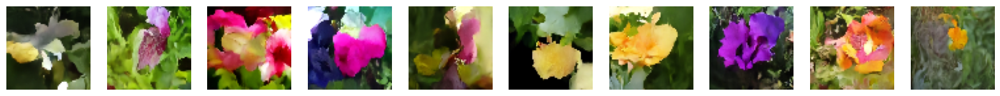

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1742
Epoch 20/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1740
Saved to ./output/generated_img_019.png


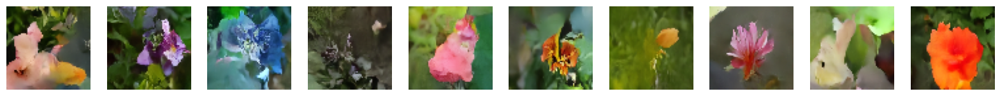

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1740
Epoch 21/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1742
Saved to ./output/generated_img_020.png


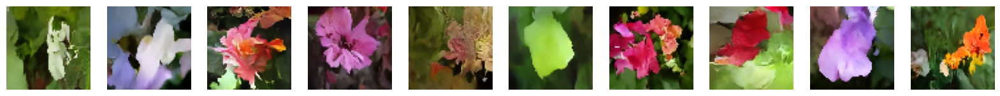

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1742
Epoch 22/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1748
Saved to ./output/generated_img_021.png


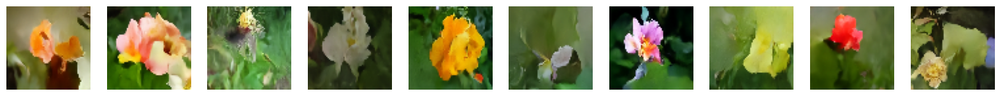

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1748
Epoch 23/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1736
Saved to ./output/generated_img_022.png


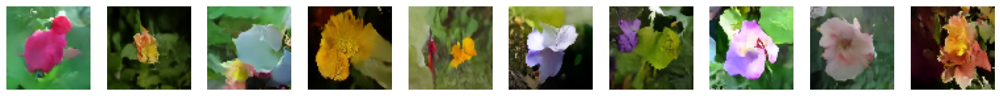

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1736
Epoch 24/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1733
Saved to ./output/generated_img_023.png


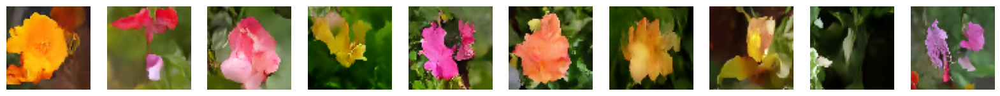

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1733
Epoch 25/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1732
Saved to ./output/generated_img_024.png


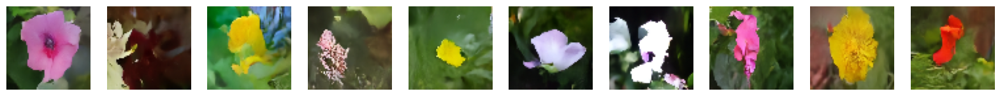

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1732
Epoch 26/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1736
Saved to ./output/generated_img_025.png


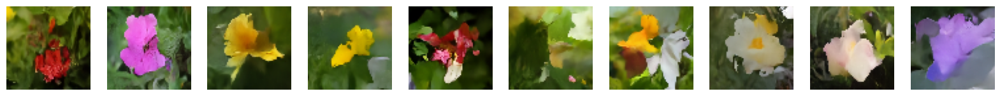

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1736
Epoch 27/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1736
Saved to ./output/generated_img_026.png


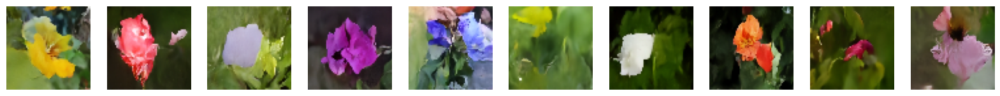

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 37ms/step - n_loss: 0.1736
Epoch 28/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1731
Saved to ./output/generated_img_027.png


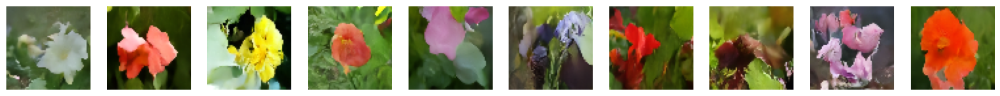

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1731
Epoch 29/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1748
Saved to ./output/generated_img_028.png


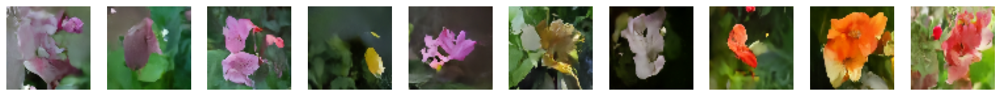

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1748
Epoch 30/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1742
Saved to ./output/generated_img_029.png


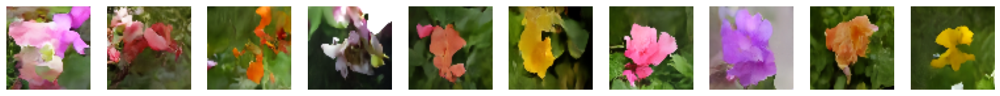

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1742
Epoch 31/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1729
Saved to ./output/generated_img_030.png


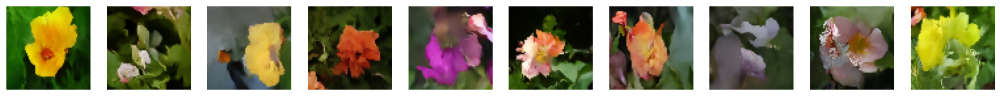

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1729
Epoch 32/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1726
Saved to ./output/generated_img_031.png


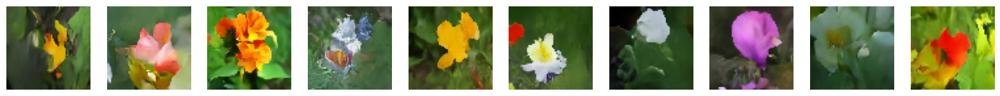

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1726
Epoch 33/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1715
Saved to ./output/generated_img_032.png


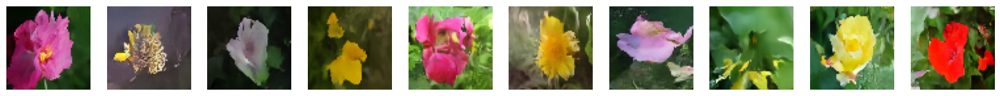

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1715
Epoch 34/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1725
Saved to ./output/generated_img_033.png


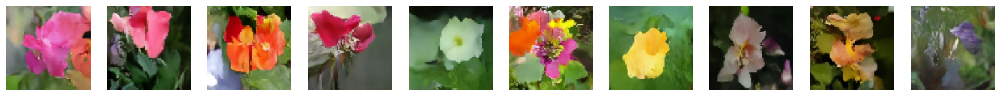

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1725
Epoch 35/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - n_loss: 0.1727
Saved to ./output/generated_img_034.png


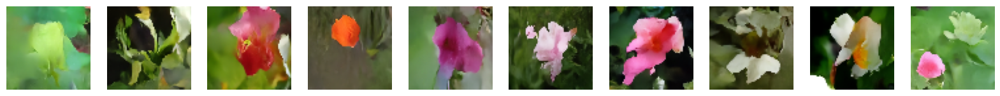

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1727
Epoch 36/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1727
Saved to ./output/generated_img_035.png


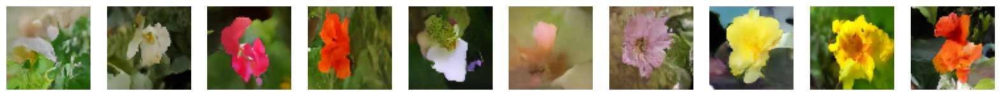

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1727
Epoch 37/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1718
Saved to ./output/generated_img_036.png


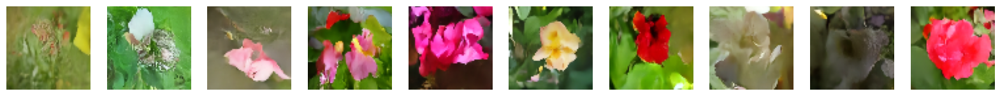

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1718
Epoch 38/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1729
Saved to ./output/generated_img_037.png


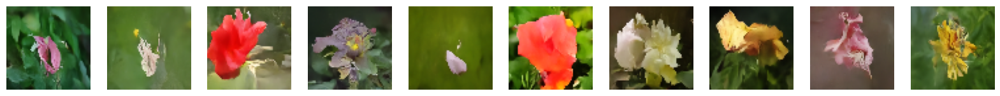

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1729
Epoch 39/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1717
Saved to ./output/generated_img_038.png


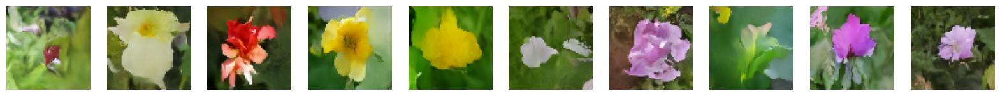

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1717
Epoch 40/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1720
Saved to ./output/generated_img_039.png


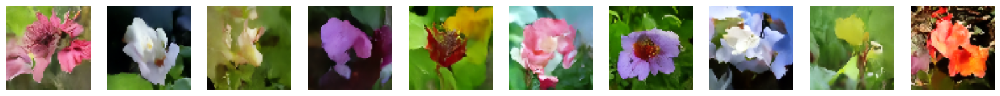

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1720
Epoch 41/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1721
Saved to ./output/generated_img_040.png


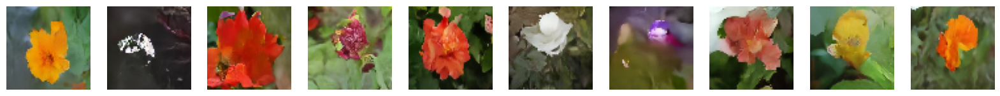

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1721
Epoch 42/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1729
Saved to ./output/generated_img_041.png


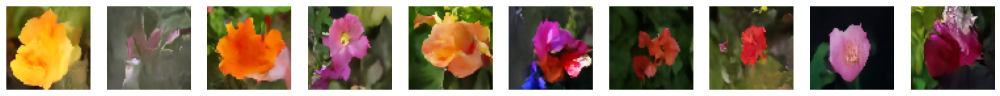

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1729
Epoch 43/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1720
Saved to ./output/generated_img_042.png


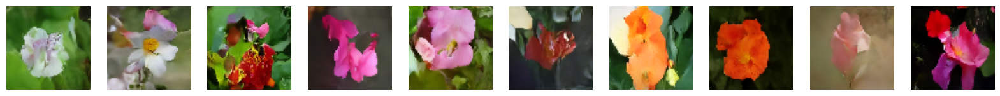

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1720
Epoch 44/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1711
Saved to ./output/generated_img_043.png


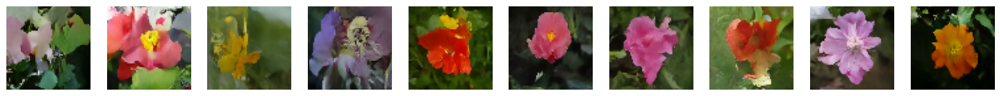

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1711
Epoch 45/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1710
Saved to ./output/generated_img_044.png


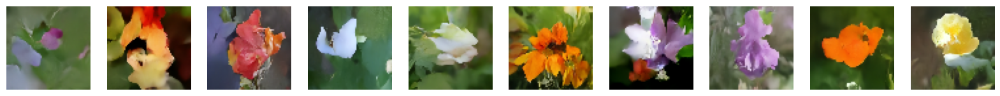

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1710
Epoch 46/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1726
Saved to ./output/generated_img_045.png


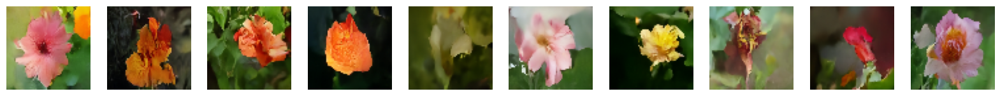

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1726
Epoch 47/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1716
Saved to ./output/generated_img_046.png


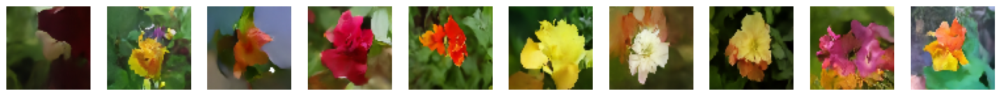

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1716
Epoch 48/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1718
Saved to ./output/generated_img_047.png


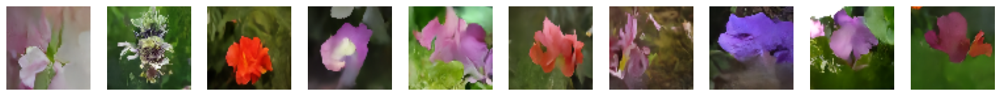

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1718
Epoch 49/50
639/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1707
Saved to ./output/generated_img_048.png


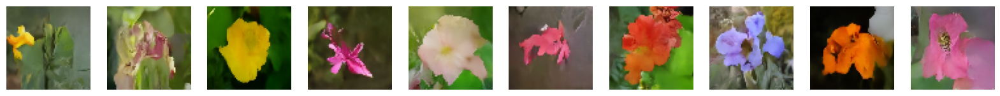

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1707
Epoch 50/50
638/639 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - n_loss: 0.1717
Saved to ./output/generated_img_049.png


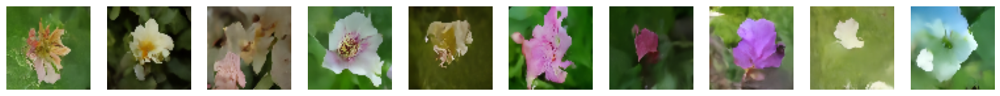

639/639 ━━━━━━━━━━━━━━━━━━━━ 23s 36ms/step - n_loss: 0.1717


In [ ]:
# 훈련을 실행하고 생성된 이미지를 주기적으로 출력합니다.
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.weights.h5",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

# 훈련 과정에서 생성된 로그를 저장해 시각화할 수 있도록 합니다.
tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


# ImageGenerator는 훈련 중 특정 에포크가 끝날 때마다 이미지를 생성하고 출력 및 저장합니다.
class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img):  # 생성할 이미지 수 (num_img)를 초기화
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):  # 에포크가 끝날 때마다 호출
        generated_images = self.model.generate(
            num_images=self.num_img,
            diffusion_steps=PLOT_DIFFUSION_STEPS,
        ).numpy()
        display(  # 생성된 이미지를 화면에 출력하거나 파일로 저장
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),
        )


image_generator_callback = ImageGenerator(num_img=10)

ddm.fit(
    train,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        image_generator_callback,
    ],
)

## 4. 추론 <a name="inference"></a>

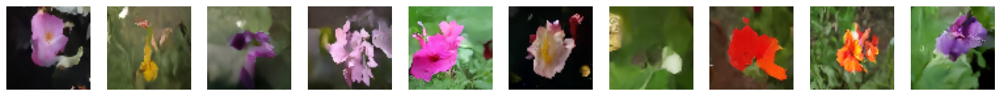

In [ ]:
# 새로운 꽃 이미지 생성
generated_images = ddm.generate(num_images=10, diffusion_steps=20).numpy()
display(generated_images)

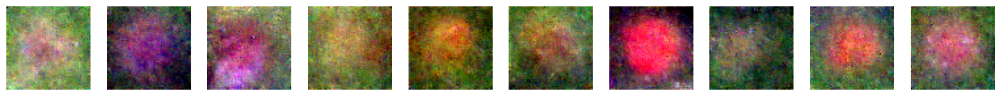

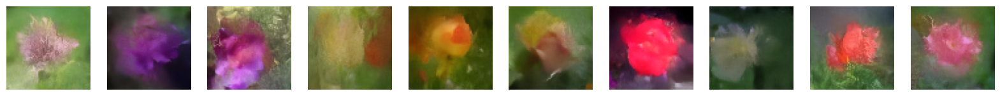

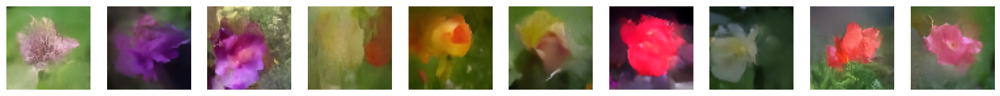

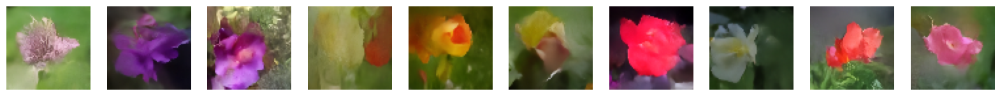

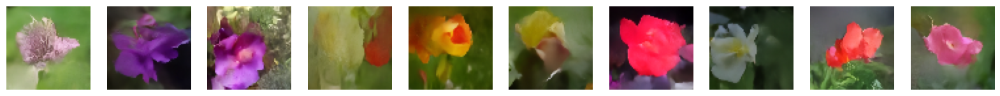

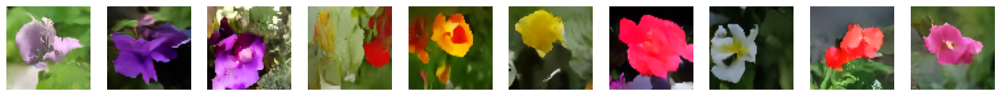

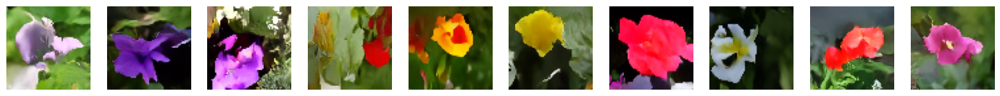

In [ ]:
# 확산 단계 증가에 따른 이미지 품질 향상 확인
for diffusion_steps in list(np.arange(1, 6, 1)) + [20] + [100]:
    tf.random.set_seed(42)
    generated_images = ddm.generate(
        num_images=10,
        diffusion_steps=diffusion_steps,
    ).numpy()
    display(generated_images)

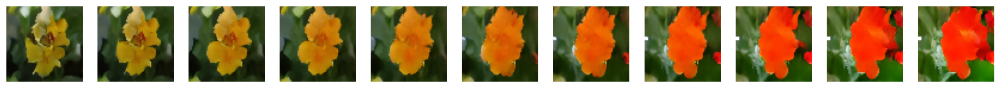

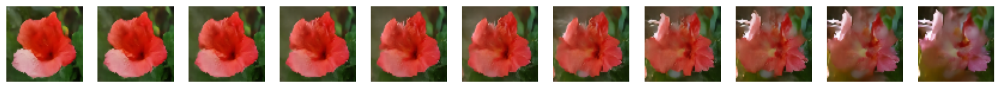

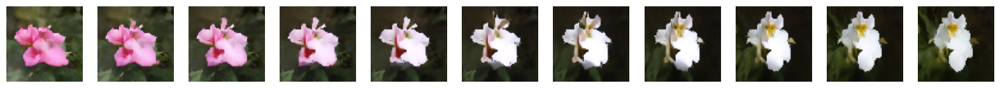

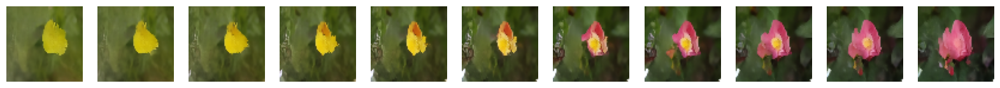

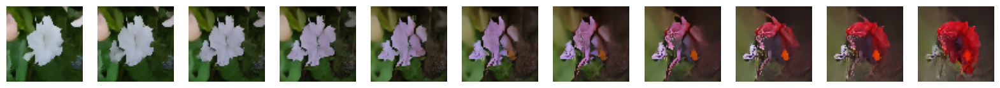

In [ ]:
# 잡음 공간에 있는 두 포인트 사이를 보간
tf.random.set_seed(100)


def spherical_interpolation(a, b, t):  # 두 점 a와 b 사이에서 구면 선형 보간을 수행
    return np.sin(t * math.pi / 2) * a + np.cos(t * math.pi / 2) * b


for i in range(5):
    a = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    b = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    initial_noise = tf.stack(
        [spherical_interpolation(a.numpy(), b.numpy(), t) for t in np.arange(0, 1.1, 0.1)]
    )
    initial_noise = tf.convert_to_tensor(initial_noise, dtype=tf.float32)
    generated_images = ddm.generate(  # Diffusion 모델을 사용해 이미지를 생성
        num_images=2, diffusion_steps=20, initial_noise=initial_noise  # 보간된 잡음을 초기값으로 사용
    ).numpy()
    display(generated_images, n=11)